# Use TensorFlow 2.5 or 2.8

In [ ]:
# Install the Object Detection API (NOTE: This block takes about 10 minutes to finish executing)

# Need to do a temporary fix with PyYAML because Colab isn't able to install PyYAML v5.4.1
!pip install pyyaml==5.3
!pip install /content/models/research/

# Need to downgrade to TF v2.8.0 due to Colab compatibility bug with TF v2.10 (as of 10/03/22)
!pip install tensorflow==2.8.0

# Install CUDA version 11.0 (to maintain compatibility with TF v2.8.0)
!pip install tensorflow_io==0.23.1
!wget https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-ubuntu1804.pin
!mv cuda-ubuntu1804.pin /etc/apt/preferences.d/cuda-repository-pin-600
!wget http://developer.download.nvidia.com/compute/cuda/11.0.2/local_installers/cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
!dpkg -i cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
!apt-key add /var/cuda-repo-ubuntu1804-11-0-local/7fa2af80.pub
!apt-get update && sudo apt-get install cuda-toolkit-11-0
!export LD_LIBRARY_PATH=/usr/local/cuda-11.0/lib64:$LD_LIBRARY_PATH

!pip install protobuf==3.20.*

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.2/268.2 kB 17.3 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
ERROR: Invalid requirement: '/content/models/research/': Expected package name at the start of dependency specifier
    /content/models/research/
    ^
Hint: It looks like a path. File '/content/models/research/' does not exist.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 497.6/497.6 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 462.5/462.5 kB 31.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Clone the tensorflow models repository from GitHub
!pip uninstall Cython -y # Temporary fix for "No module named 'object_detection'" error
!git clone --depth 1 https://github.com/tensorflow/models

Found existing installation: Cython 3.0.11
Uninstalling Cython-3.0.11:
  Successfully uninstalled Cython-3.0.11
Cloning into 'models'...
remote: Enumerating objects: 4305, done.
remote: Counting objects: 100% (4305/4305), done.
remote: Compressing objects: 100% (3315/3315), done.
remote: Total 4305 (delta 1212), reused 2205 (delta 917), pack-reused 0 (from 0)
Receiving objects: 100% (4305/4305), 53.16 MiB | 17.54 MiB/s, done.
Resolving deltas: 100% (1212/1212), done.


In [ ]:
# Copy setup files into models/research folder
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
#cp object_detection/packages/tf2/setup.py .

In [ ]:
# Modify setup.py file to install the tf-models-official repository targeted at TF v2.8.0
import re
with open('/content/models/research/object_detection/packages/tf2/setup.py') as f:
    s = f.read()

with open('/content/models/research/setup.py', 'w') as f:
    # Set fine_tune_checkpoint path
    s = re.sub('tf-models-official>=2.5.1',
               'tf-models-official==2.8.0', s)
    f.write(s)

In [ ]:
%cd /content/models/research/
!python setup.py install

/content/models/research
running install
/usr/local/lib/python3.10/dist-packages/setuptools/_distutils/cmd.py:66: SetuptoolsDeprecationWarning: setup.py install is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` directly.
        Instead, use pypa/build, pypa/installer or other
        standards-based tools.

        See https://blog.ganssle.io/articles/2021/10/setup-py-deprecated.html for details.
        ********************************************************************************

!!
  self.initialize_options()
/usr/local/lib/python3.10/dist-packages/setuptools/_distutils/cmd.py:66: EasyInstallDeprecationWarning: easy_install command is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` and ``easy_install``.
        Instead, use pypa/build, pypa/installer or other
        standards-based 

In [ ]:
!ls /content/models/research/object_detection/builders/

anchor_generator_builder.py	    input_reader_builder_tf1_test.py
anchor_generator_builder_test.py    losses_builder.py
box_coder_builder.py		    losses_builder_test.py
box_coder_builder_test.py	    matcher_builder.py
box_predictor_builder.py	    matcher_builder_test.py
box_predictor_builder_test.py	    model_builder.py
calibration_builder.py		    model_builder_test.py
calibration_builder_test.py	    model_builder_tf1_test.py
dataset_builder.py		    model_builder_tf2_test.py
dataset_builder_test.py		    optimizer_builder.py
decoder_builder.py		    optimizer_builder_tf1_test.py
decoder_builder_test.py		    optimizer_builder_tf2_test.py
graph_rewriter_builder.py	    post_processing_builder.py
graph_rewriter_builder_tf1_test.py  post_processing_builder_test.py
hyperparams_builder.py		    preprocessor_builder.py
hyperparams_builder_test.py	    preprocessor_builder_test.py
image_resizer_builder.py	    region_similarity_calculator_builder.py
image_resizer_builder_test.py	    region_similarity

In [ ]:
# Run Model Bulider Test file, just to verify everything's working properly
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py

Running tests under Python 3.10.12: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2024-12-06 10:27:54.516313: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
W1206 10:27:55.496887 135168610001536 model_builder.py:1112] Building experimental DeepMAC meta-arch. Some features may be omitted.
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 4.29s
I1206 10:27:56.162168 135168610001536 test_util.py:2373] time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 4.29s
[       OK ] ModelBuilderTF2Test.test_create_center_net_deepmac
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)): 0.6s
I1206 10:27:56.765691 135168610001536 test

# Download Dataset

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="jxLOGL9QrtfqTWVk2pK4")
project = rf.workspace("nutrition-fact-anotating").project("nutrition-fact")
version = project.version(6)
dataset = version.download("tfrecord")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.9/80.9 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.4 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.17.0 requires tensorflow<2.18,>=2.17, but you have tensorflow 2.8.0 which is incompatible.
tf-models-official 2.8.0 requires pyyaml<6.0,>=5.1, but you have pyyaml 6.0.2 which is incompatible.
apache-beam 2.61.0 requires cloudpickle~=2.2.1, but you have cloudpickle 3.1.0 which is incompatible.
apache-beam 2.61.0 requires grpcio!=1.48.0,!=1.59.*,!=1.60.*,!=1.61.*,!=1.62.0,!=1.62.1,<1.66.0,<2,>=1.33.1, but you have grpcio 1.68.1 which is incompatible.
apache-beam 2.61.0 requires jsonpickle<4.0.0,>=3.0.0, but you ha


Extracting Dataset Version Zip to nutrition-fact-6 in tfrecord:: 100%|██████████| 11/11 [00:00<00:00, 271.70it/s]


In [ ]:
train_record_fname = dataset.location + '/train/kandungan-gizi.tfrecord'
valid_record_fname = dataset.location + '/valid/kandungan-gizi.tfrecord'
label_map_pbtxt_fname = dataset.location + '/train/kandungan-gizi_label_map.pbtxt'

# Model Config

In [ ]:
MODELS_CONFIG = {
    'efficientdet-d1': {
        'model_name': 'efficientdet_d1_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d1_640x640_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d1_coco17_tpu-32.tar.gz',
        'batch_size': 4
    },
    'ssd-mobilenet-v2': {
        'model_name': 'ssd_mobilenet_v2_320x320_coco17_tpu-8',
        'base_pipeline_file': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.config',
        'pretrained_checkpoint': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz',
        'batch_size': 4
    },
}

chosen_model = 'ssd-mobilenet-v2'

num_steps = 40000
num_eval_steps = 500

model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']
batch_size = MODELS_CONFIG[chosen_model]['batch_size']

In [ ]:
#download pretrained weights
%mkdir /content/models/research/deploy/
%cd /content/models/research/deploy/
import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint

!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()

# Download training configuration file for model
download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/' + base_pipeline_file
!wget {download_config}

/content/models/research/deploy
--2024-12-06 10:31:03--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 142.251.175.207, 142.251.10.207, 142.251.12.207, ...
Connecting to download.tensorflow.org (download.tensorflow.org)|142.251.175.207|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 46042990 (44M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_32 100%[===================>]  43.91M  14.4MB/s    in 3.1s    

2024-12-06 10:31:07 (14.4 MB/s) - ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz’ saved [46042990/46042990]

--2024-12-06 10:31:07--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_320x320_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.11

In [ ]:
import sys
sys.path.append('/content/models/research') # Add the path to the parent of object_detection module

#prepare
pipeline_fname = '/content/models/research/deploy/' + base_pipeline_file
fine_tune_checkpoint = '/content/models/research/deploy/' + model_name + '/checkpoint/ckpt-0'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util # This import should now work
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)

In [ ]:
# Create custom configuration file by writing the dataset, model checkpoint, and training parameters into the base pipeline file
import re

%cd /content/models/research/deploy
print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:

    # Set fine_tune_checkpoint path
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)

    # Set tfrecord files for train and test datasets
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(valid_record_fname), s)

    # Set label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set batch_size
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)

    # Set number of classes num_classes
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)

    # Change fine-tune checkpoint type from "classification" to "detection"
    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)

    # If using ssd-mobilenet-v2, reduce learning rate (because it's too high in the default config file)
    if chosen_model == 'ssd-mobilenet-v2':
      s = re.sub('learning_rate_base: .8',
                 'learning_rate_base: .08', s)

      s = re.sub('warmup_learning_rate: 0.13333',
                 'warmup_learning_rate: .026666', s)

    # If using efficientdet-d0, use fixed_shape_resizer instead of keep_aspect_ratio_resizer (because it isn't supported by TFLite)
    if chosen_model == 'efficientdet-d0':
      s = re.sub('keep_aspect_ratio_resizer', 'fixed_shape_resizer', s)
      s = re.sub('pad_to_max_dimension: true', '', s)
      s = re.sub('min_dimension', 'height', s)
      s = re.sub('max_dimension', 'width', s)

    f.write(s)


/content/models/research/deploy
writing custom configuration file


In [ ]:
%cat /content/models/research/deploy/pipeline_file.config

# SSD with Mobilenet v2
# Trained on COCO17, initialized from Imagenet classification checkpoint
# Train on TPU-8
#
# Achieves 22.2 mAP on COCO17 Val

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 9
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      ssd_anchor_generator {
        num_layers: 6
        min_scale: 0.2
        max_scale: 0.95
        aspect_ratios: 1.0
        aspect_ratios: 2.0
        aspect_ratios: 0.5
        aspect_ratios: 3.0
 

In [ ]:
pipeline_file = '/content/models/research/deploy/pipeline_file.config'
model_dir = '/content/training/'

# Training

In [ ]:
!pip list

Package                            Version
---------------------------------- -------------------
absl-py                            1.4.0
accelerate                         1.1.1
aiohappyeyeballs                   2.4.3
aiohttp                            3.11.2
aiosignal                          1.3.1
alabaster                          1.0.0
albucore                           0.0.19
albumentations                     1.4.20
altair                             4.2.2
annotated-types                    0.7.0
anyio                              3.7.1
apache-beam                        2.61.0
argon2-cffi                        23.1.0
argon2-cffi-bindings               21.2.0
array_record                       0.5.1
arviz                              0.20.0
astropy                            6.1.6
astropy-iers-data                  0.2024.11.18.0.35.2
astunparse                         1.6.3
async-timeout                      4.0.3
atpublic                           4.1.0
attrs               

In [ ]:
!pip uninstall tensorflow-addons
!pip install tensorflow-addons==0.18.0

Found existing installation: tensorflow-addons 0.23.0
Uninstalling tensorflow-addons-0.23.0:
  Would remove:
    /usr/local/lib/python3.10/dist-packages/tensorflow_addons-0.23.0-py3.10-linux-x86_64.egg
Proceed (Y/n)? y
  Successfully uninstalled tensorflow-addons-0.23.0
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 47.1 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-models-official 2.8.0 requires pyyaml<6.0,>=5.1, but you have pyyaml 6.0.2 which is incompatible.


In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps=20000 \
    --sample_1_of_n_eval_examples=1 \

2024-12-06 10:36:12.845675: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I1206 10:36:12.853996 138381836956288 mirrored_strategy.py:374] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 20000
I1206 10:36:12.858459 138381836956288 config_util.py:552] Maybe overwriting train_steps: 20000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1206 10:36:12.858615 138381836956288 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W1206 10:36:12.900279 138381836956288 deprecation.py:337] From /usr/local/lib/python3.10/dist-packages/object_detection-0.1-py3.10.egg/object_detection/model_lib

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/train'

<IPython.core.display.Javascript object>

# Convert to TFLite

In [ ]:
# Make a directory to store the trained TFLite model
!mkdir /content/custom_model_lite
output_directory = '/content/custom_model_tflite'

# Path to training directory (the conversion script automatically chooses the highest checkpoint file)
last_model_path = '/content/training'

!python /content/models/research/object_detection/export_tflite_graph_tf2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

mkdir: cannot create directory ‘/content/custom_model_lite’: File exists
2024-12-06 11:17:23.863486: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
I1206 11:17:35.834841 140063843193472 api.py:441] feature_map_spatial_dims: [(19, 19), (10, 10), (5, 5), (3, 3), (2, 2), (1, 1)]
INFO:tensorflow:depth of additional conv before box predictor: 0
I1206 11:17:42.710199 140063843193472 convolutional_keras_box_predictor.py:152] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I1206 11:17:42.710628 140063843193472 convolutional_keras_box_predictor.py:152] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I1206 11:17:42.710887 140063843193472 convolutional_keras_box_predictor.py:152] depth of additional conv before box predictor: 

In [ ]:
output_directory = '/content/custom_model'
!python /content/models/research/object_detection/exporter_main_v2.py \
    --input_type image_tensor \
    --pipeline_config_path {pipeline_file} \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory}

2024-12-06 11:14:38.080992: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W1206 11:14:38.242975 138427641246336 deprecation.py:610] From /usr/local/lib/python3.10/dist-packages/tensorflow/python/autograph/impl/api.py:458: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
I1206 11:14:42.589111 1384276412

In [ ]:
import tensorflow as tf

converter = tf.lite.TFLiteConverter.from_saved_model('/content/custom_model_tflite/saved_model')
tflite_model = converter.convert()

with open('/content/custom_model_lite/detect.tflite', 'wb') as f:
  f.write(tflite_model)

In [ ]:
import re

def convert_pbtxt_to_labelmap(pbtxt_path, output_path):
    with open(pbtxt_path, 'r') as pbtxt_file:
        pbtxt_content = pbtxt_file.read()

    # Gunakan regex untuk menangkap blok item
    items = re.findall(r'item\s*{(.*?)}', pbtxt_content, re.DOTALL)

    # Parse setiap item untuk mendapatkan id dan name
    ids = []
    names = []
    for item in items:
        item_id = re.search(r'id:\s*(\d+)', item)
        item_name = re.search(r'name:\s*"(.*?)"', item)
        if item_id and item_name:
            ids.append(item_id.group(1))
            names.append(item_name.group(1))

    print(f"IDs: {ids}")
    print(f"Names: {names}")

    # Tulis ke labelmap.txt
    with open(output_path, 'w') as labelmap_file:
        for label_name in names:
            labelmap_file.write(f"{label_name}\n")
            print(label_name)

    print(f"Labelmap saved to {output_path}")

# Contoh penggunaan
convert_pbtxt_to_labelmap(label_map_pbtxt_fname, '/content/custom_model_lite/labels.txt')
convert_pbtxt_to_labelmap(label_map_pbtxt_fname, '/content/custom_model/labels.txt')


IDs: ['1', '2', '3', '4', '5', '6', '7', '8', '9']
Names: ['energi', 'gula', 'karbohidrat', 'lemak', 'lemak jenuh', 'natrium', 'nutrition_box', 'protein', 'quantity']
energi
gula
karbohidrat
lemak
lemak jenuh
natrium
nutrition_box
protein
quantity
Labelmap saved to /content/custom_model_lite/labels.txt
IDs: ['1', '2', '3', '4', '5', '6', '7', '8', '9']
Names: ['energi', 'gula', 'karbohidrat', 'lemak', 'lemak jenuh', 'natrium', 'nutrition_box', 'protein', 'quantity']
energi
gula
karbohidrat
lemak
lemak jenuh
natrium
nutrition_box
protein
quantity
Labelmap saved to /content/custom_model/labels.txt


In [ ]:
# prompt: zip the /content/custom_model_lite

!zip -r /content/custom_model_lite.zip /content/custom_model_lite


updating: content/custom_model_lite/ (stored 0%)
updating: content/custom_model_lite/detect.tflite (deflated 7%)
updating: content/custom_model_lite/labels.txt (deflated 16%)


In [ ]:
!zip -r /content/custom_model.zip /content/custom_model

updating: content/custom_model/ (stored 0%)
updating: content/custom_model/saved_model/ (stored 0%)
updating: content/custom_model/saved_model/saved_model.pb (deflated 92%)
updating: content/custom_model/saved_model/assets/ (stored 0%)
updating: content/custom_model/saved_model/variables/ (stored 0%)
updating: content/custom_model/saved_model/variables/variables.index (deflated 76%)
updating: content/custom_model/saved_model/variables/variables.data-00000-of-00001 (deflated 8%)
updating: content/custom_model/labels.txt (deflated 16%)
updating: content/custom_model/checkpoint/ (stored 0%)
updating: content/custom_model/checkpoint/ckpt-0.data-00000-of-00001 (deflated 7%)
updating: content/custom_model/checkpoint/ckpt-0.index (deflated 78%)
updating: content/custom_model/checkpoint/checkpoint (deflated 41%)
updating: content/custom_model/pipeline.config (deflated 69%)


In [ ]:
from google.colab import files
files.download("/content/custom_model_lite.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Test TFLite Model

In [ ]:
def tflite_detect_image(modelpath, image_path, lblpath, min_conf=0.5, savepath='/content/results', txt_only=False):


    # Load the label map into memory
    with open(lblpath, 'r') as f:
        labels = [line.strip() for line in f.readlines()]
        for idx, label in enumerate(labels):
            print(f"Label index {idx}: {label}")

    # Load the TensorFlow Lite model into memory
    interpreter = Interpreter(model_path=modelpath)
    interpreter.allocate_tensors()

    # Get model details
    input_details = interpreter.get_input_details()
    output_details = interpreter.get_output_details()
    height = input_details[0]['shape'][1]
    width = input_details[0]['shape'][2]
    float_input = (input_details[0]['dtype'] == np.float32)

    input_mean = 127.5
    input_std = 127.5

    # Load image and resize to expected shape [1xHxWx3]
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    imH, imW, _ = image.shape
    image_resized = cv2.resize(image_rgb, (width, height))
    input_data = np.expand_dims(image_resized, axis=0)

    # Normalize pixel values if using a floating-point model (non-quantized model)
    if float_input:
        input_data = (np.float32(input_data) - input_mean) / input_std

    # Perform the actual detection by running the model with the image as input
    interpreter.set_tensor(input_details[0]['index'], input_data)
    interpreter.invoke()

    # Retrieve detection results
    boxes = interpreter.get_tensor(output_details[1]['index'])[0]  # Bounding box coordinates
    classes = interpreter.get_tensor(output_details[3]['index'])[0]  # Class index
    scores = interpreter.get_tensor(output_details[0]['index'])[0]  # Confidence scores

    detections = []

    # Loop over all detections and filter based on the confidence threshold
    for i in range(len(scores)):
        if ((scores[i] > min_conf) and (scores[i] <= 1.0)):

            # Get bounding box coordinates and draw box
            ymin = int(max(1, (boxes[i][0] * imH)))
            xmin = int(max(1, (boxes[i][1] * imW)))
            ymax = int(min(imH, (boxes[i][2] * imH)))
            xmax = int(min(imW, (boxes[i][3] * imW)))

            # Get the label for the detected class
            object_name = labels[int(classes[i])]
            label = '%s: %d%%' % (object_name, int(scores[i] * 100))
            detections.append([object_name, scores[i], xmin, ymin, xmax, ymax])

    if not txt_only:
        # Draw rectangles and labels on the image
        for detection in detections:
            cv2.rectangle(image, (detection[2], detection[3]), (detection[4], detection[5]), (10, 255, 0), 2)
            label = '%s: %.2f%%' % (detection[0], detection[1] * 100)
            cv2.putText(image, label, (detection[2], detection[3] - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Show the image with detections
        plt.figure(figsize=(12, 16))
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()

    else:
        # Save detection results to a .txt file
        image_fn = os.path.basename(image_path)
        base_fn, ext = os.path.splitext(image_fn)
        txt_result_fn = base_fn + '.txt'
        txt_savepath = os.path.join(savepath, txt_result_fn)
        with open(txt_savepath, 'w') as f:
            for detection in detections:
                f.write('%s %.4f %d %d %d %d\n' % (detection[0], detection[1], detection[2], detection[3], detection[4], detection[5]))

    return detections



Label index 0: energi
Label index 1: gula
Label index 2: karbohidrat
Label index 3: lemak
Label index 4: lemak jenuh
Label index 5: natrium
Label index 6: nutrition_box
Label index 7: protein
Label index 8: quantity


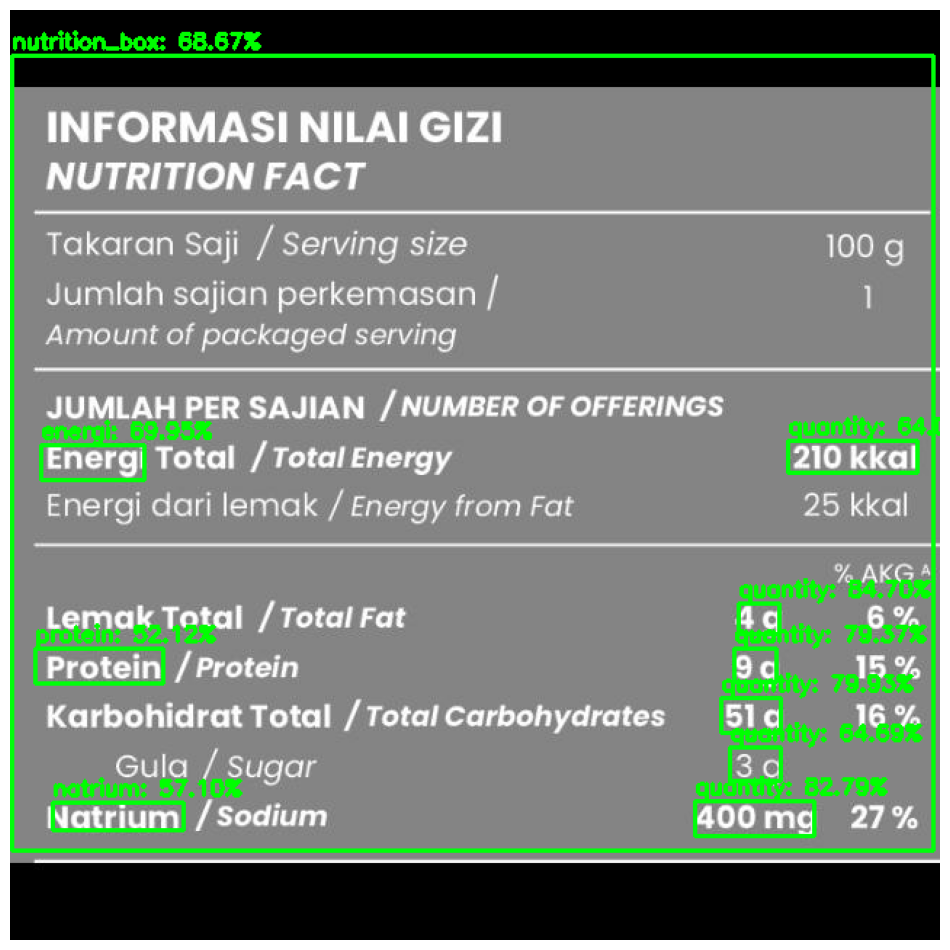

['quantity', 0.8469918, 501, 408, 529, 429]
['quantity', 0.827873, 471, 544, 553, 568]
['quantity', 0.799343, 489, 473, 530, 497]
['quantity', 0.79365444, 498, 439, 527, 462]
['energi', 0.6995157, 21, 299, 92, 323]
['nutrition_box', 0.68671787, 1, 31, 635, 578]
['quantity', 0.6469171, 495, 507, 530, 530]
['quantity', 0.64013934, 535, 296, 624, 318]
['natrium', 0.57097995, 29, 545, 119, 564]
['protein', 0.5212427, 17, 439, 105, 463]


In [ ]:
from tensorflow.lite.python.interpreter import Interpreter
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt

model_path = '/content/custom_model_lite/detect.tflite'
image_path = '/content/info-gizi-mie-goreng-sundoro-salah-satu-pilihan-mie-untuk-diet_png.rf.fbeb9d99fa29ca4de7cb987ca929fa47.jpg'
label_path = '/content/custom_model_lite/labels.txt'

detections = tflite_detect_image(modelpath=model_path,
                                 image_path=image_path,
                                 lblpath=label_path,
                                 min_conf=0.2,
                                 txt_only=False)

# Print detected objects
for detection in detections:
    print(detection)


In [ ]:
# Script to run custom TFLite model on test images to detect objects
# Source: https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/TFLite_detection_image.py

# Import packages
import os
import cv2
import numpy as np
import sys
import glob
import random
import importlib.util
from tensorflow.lite.python.interpreter import Interpreter

import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

### Define function for inferencing with TFLite model and displaying results

def tflite_detect_images(modelpath, imgpath, lblpath, min_conf=0.5, num_test_images=10, savepath='/content/results', txt_only=False):

  # Grab filenames of all images in test folder
  images = glob.glob(imgpath + '/*.jpg') + glob.glob(imgpath + '/*.JPG') + glob.glob(imgpath + '/*.png') + glob.glob(imgpath + '/*.bmp')

  # Load the label map into memory
  with open(lblpath, 'r') as f:
      labels = [line.strip() for line in f.readlines()]
      for idx, label in enumerate(labels):
          print(f"Label index {idx}: {label}")

  # Load the Tensorflow Lite model into memory
  interpreter = Interpreter(model_path=modelpath)
  interpreter.allocate_tensors()

  # Get model details
  input_details = interpreter.get_input_details()
  output_details = interpreter.get_output_details()
  height = input_details[0]['shape'][1]
  width = input_details[0]['shape'][2]

  float_input = (input_details[0]['dtype'] == np.float32)

  input_mean = 127.5
  input_std = 127.5

  # Randomly select test images
  images_to_test = random.sample(images, num_test_images)

  # Loop over every image and perform detection
  for image_path in images_to_test:

    # Load image and resize to expected shape [1xHxWx3]
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    imH, imW, _ = image.shape
    image_resized = cv2.resize(image_rgb, (width, height))
    input_data = np.expand_dims(image_resized, axis=0)

    # Normalize pixel values if using a floating model (i.e. if model is non-quantized)
    if float_input:
        input_data = (np.float32(input_data) - input_mean) / input_std

    # Perform the actual detection by running the model with the image as input
    interpreter.set_tensor(input_details[0]['index'],input_data)
    interpreter.invoke()

    # Retrieve detection results
    boxes = interpreter.get_tensor(output_details[1]['index'])[0] # Bounding box coordinates of detected objects
    classes = interpreter.get_tensor(output_details[3]['index'])[0] # Class index of detected objects
    scores = interpreter.get_tensor(output_details[0]['index'])[0] # Confidence of detected objects

    detections = []

    # Loop over all detections and draw detection box if confidence is above minimum threshold
    for i in range(len(scores)):
        if ((scores[i] > min_conf) and (scores[i] <= 1.0)):

            # Get bounding box coordinates and draw box
            ymin = int(max(1,(boxes[i][0] * imH)))
            xmin = int(max(1,(boxes[i][1] * imW)))
            ymax = int(min(imH,(boxes[i][2] * imH)))
            xmax = int(min(imW,(boxes[i][3] * imW)))

            # Draw rectangle and label
            object_name = labels[int(classes[i])]
            label = '%s: %d%%' % (object_name, int(scores[i]*100))
            detections.append([object_name, scores[i], xmin, ymin, xmax, ymax])

    if not txt_only:
        # Draw rectangles and labels on the image
        for detection in detections:
            cv2.rectangle(image, (detection[2], detection[3]), (detection[4], detection[5]), (10, 255, 0), 2)
            label = '%s: %.2f%%' % (detection[0], detection[1] * 100)
            cv2.putText(image, label, (detection[2], detection[3] - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Show the image
        plt.figure(figsize=(12,16))
        plt.imshow(image)
        plt.axis('off')
        plt.show()

    else:
        # Save detection results in .txt files
        image_fn = os.path.basename(image_path)
        base_fn, ext = os.path.splitext(image_fn)
        txt_result_fn = base_fn +'.txt'
        txt_savepath = os.path.join(savepath, txt_result_fn)
        with open(txt_savepath,'w') as f:
            for detection in detections:
                f.write('%s %.4f %d %d %d %d\n' % (detection[0], detection[1], detection[2], detection[3], detection[4], detection[5]))

  return

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Label index 0: energi
Label index 1: gula
Label index 2: karbohidrat
Label index 3: lemak
Label index 4: lemak jenuh
Label index 5: natrium
Label index 6: nutrition_box
Label index 7: protein
Label index 8: quantity


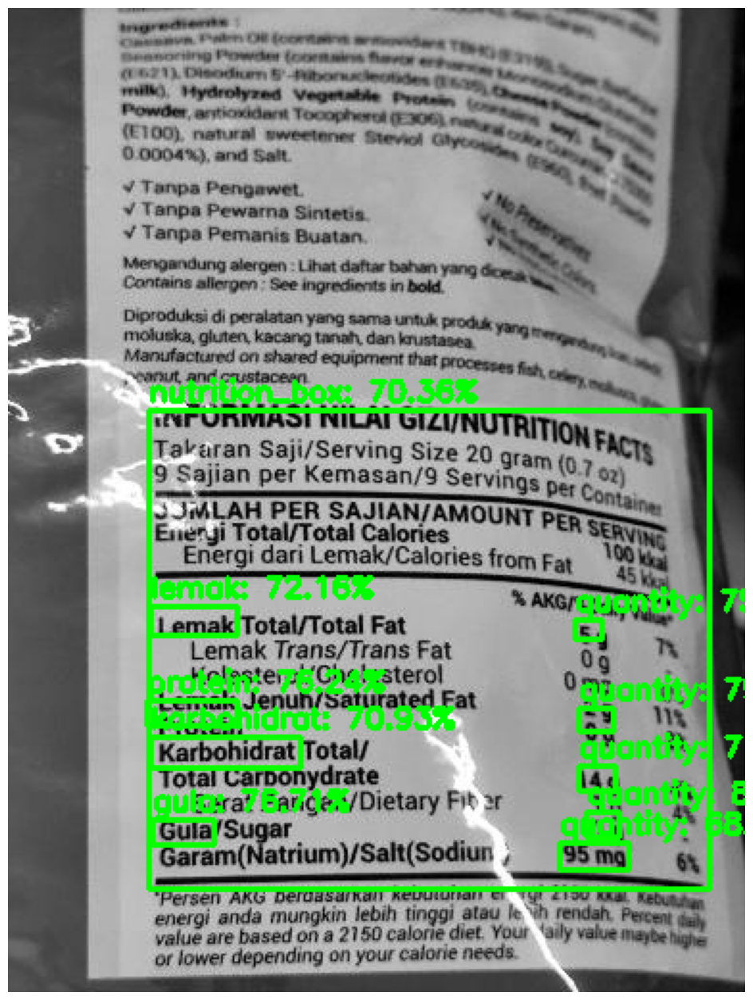

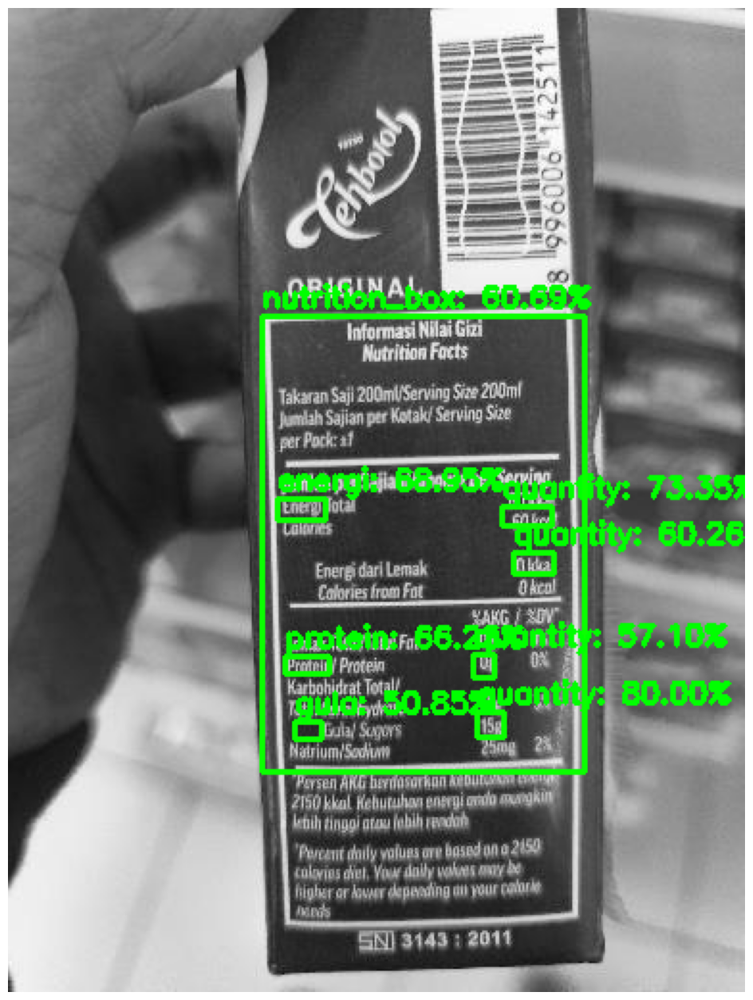

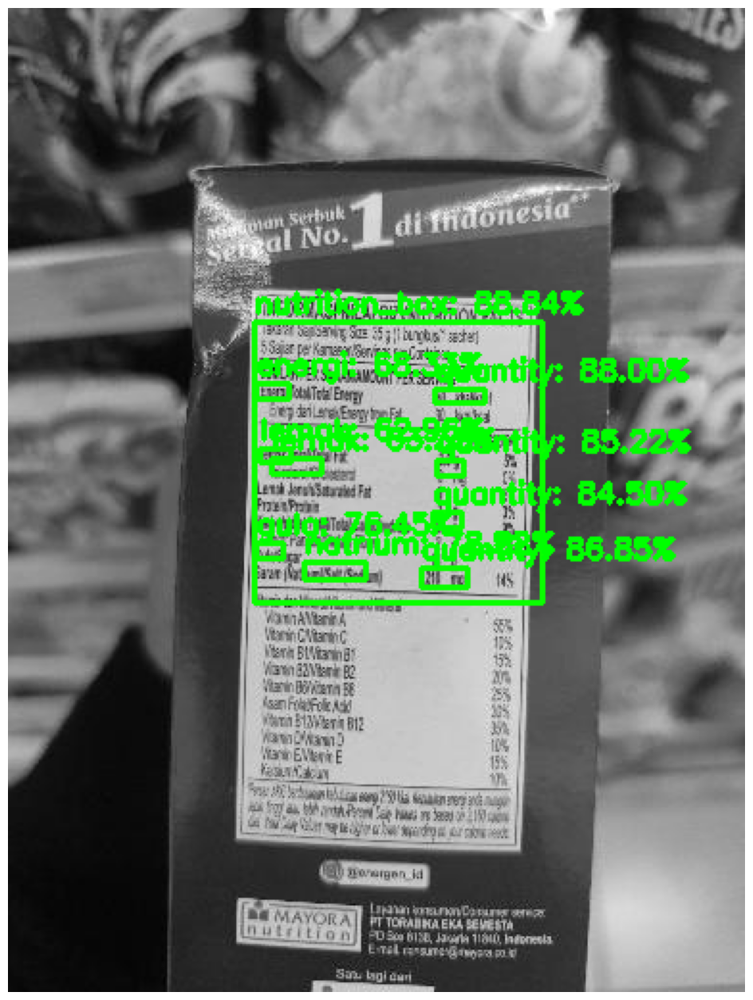

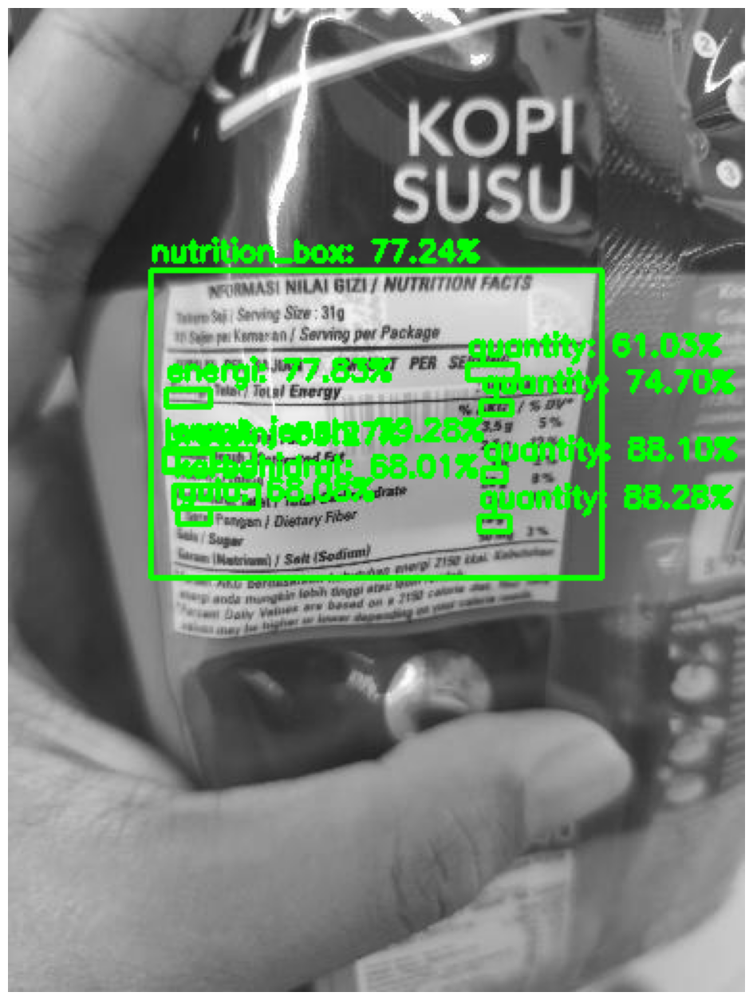

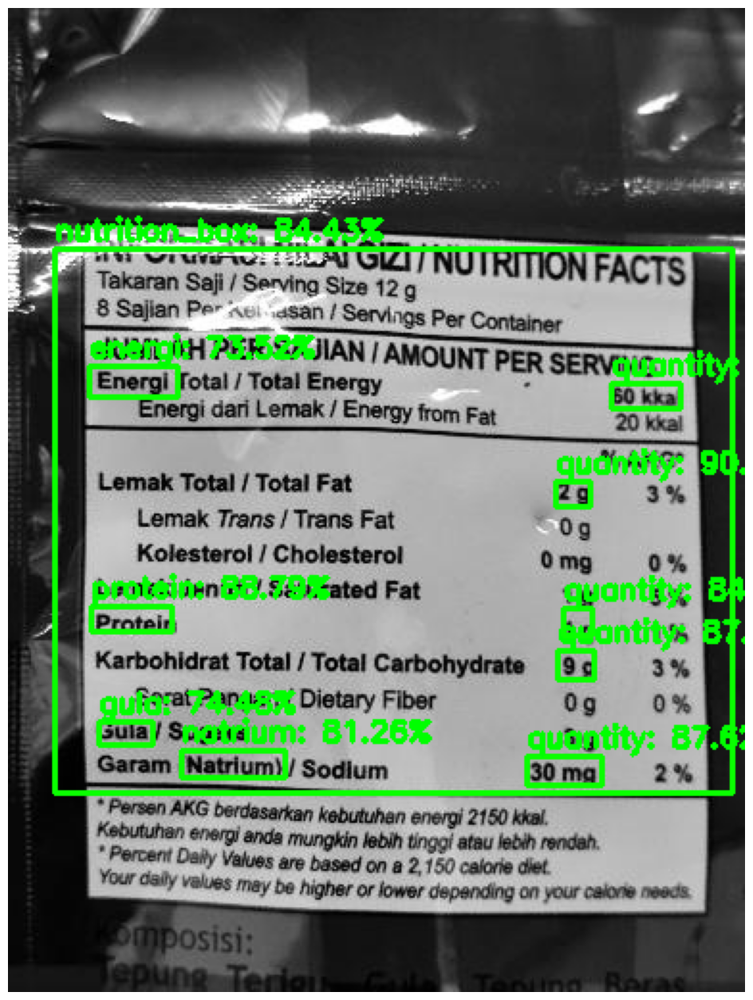

...

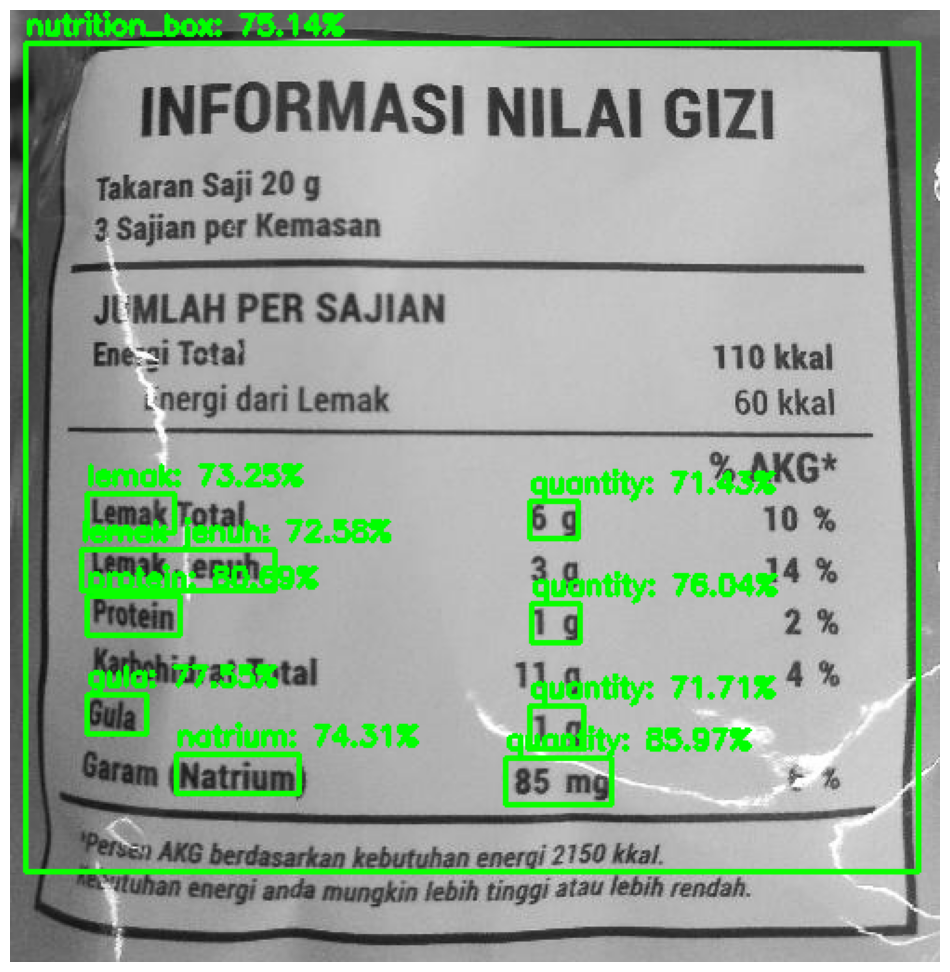

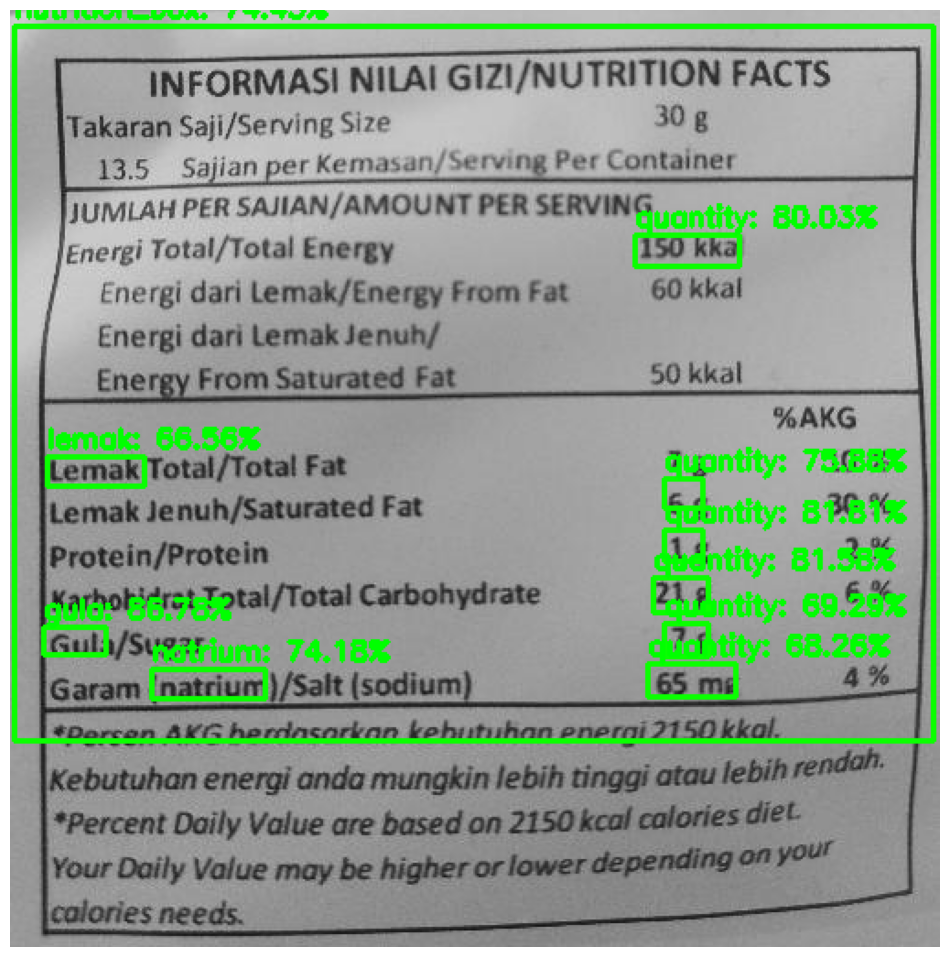

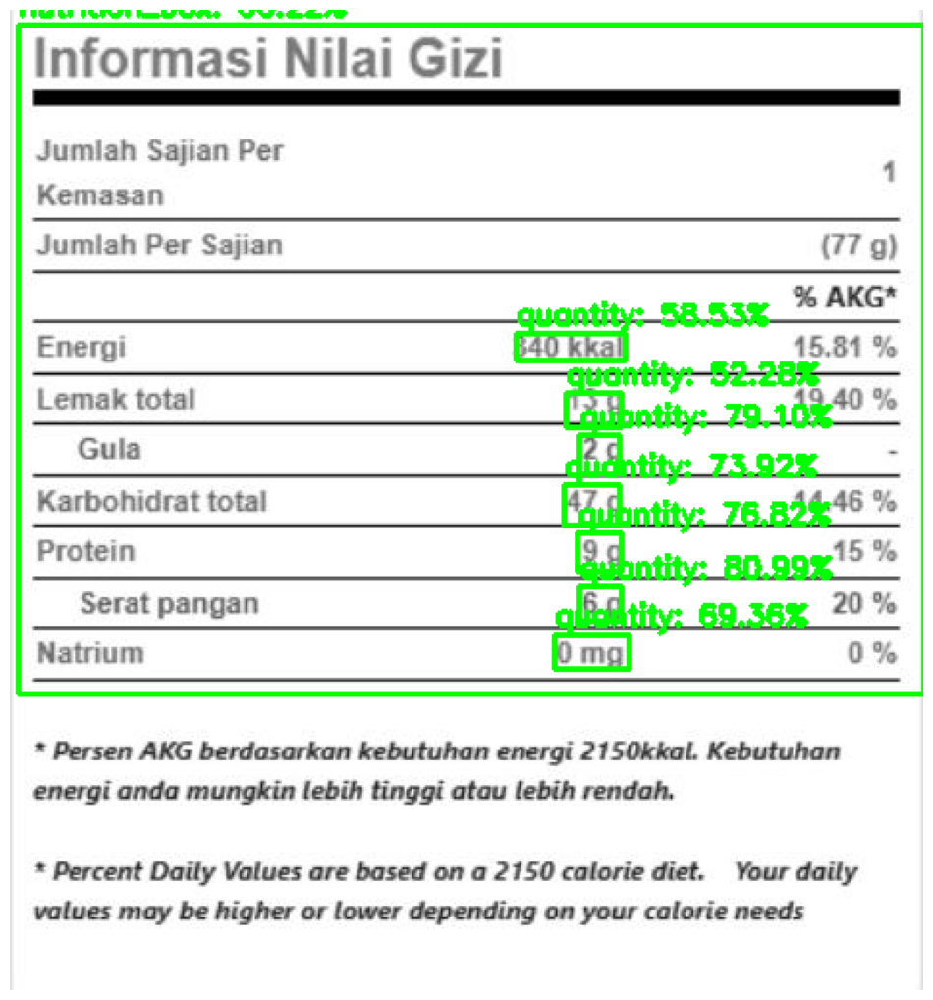

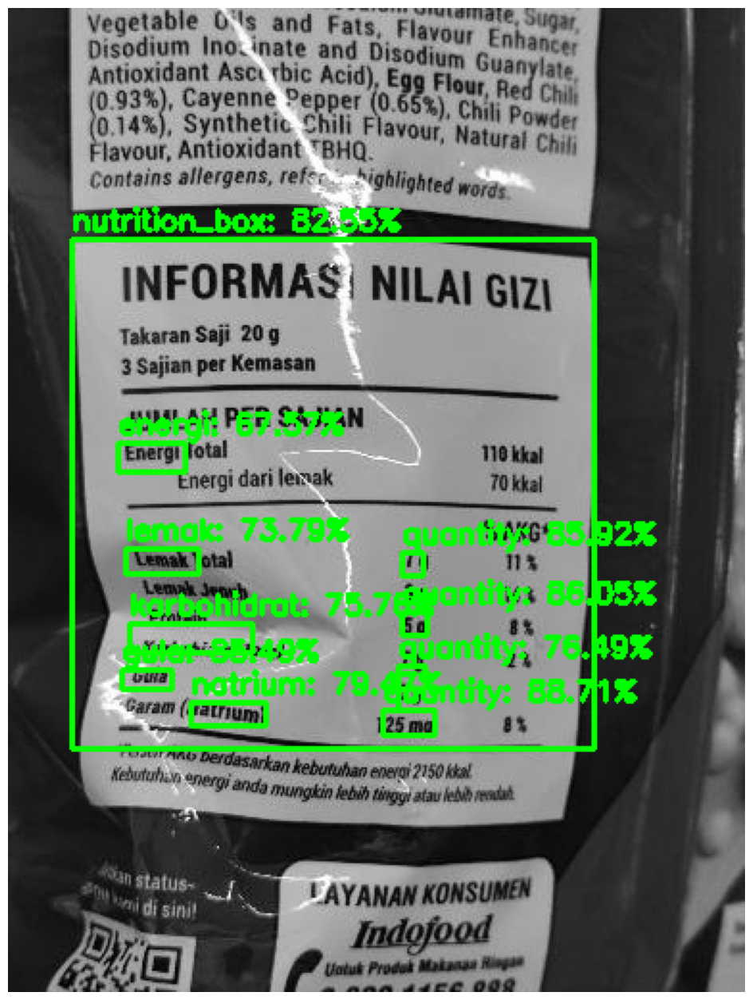

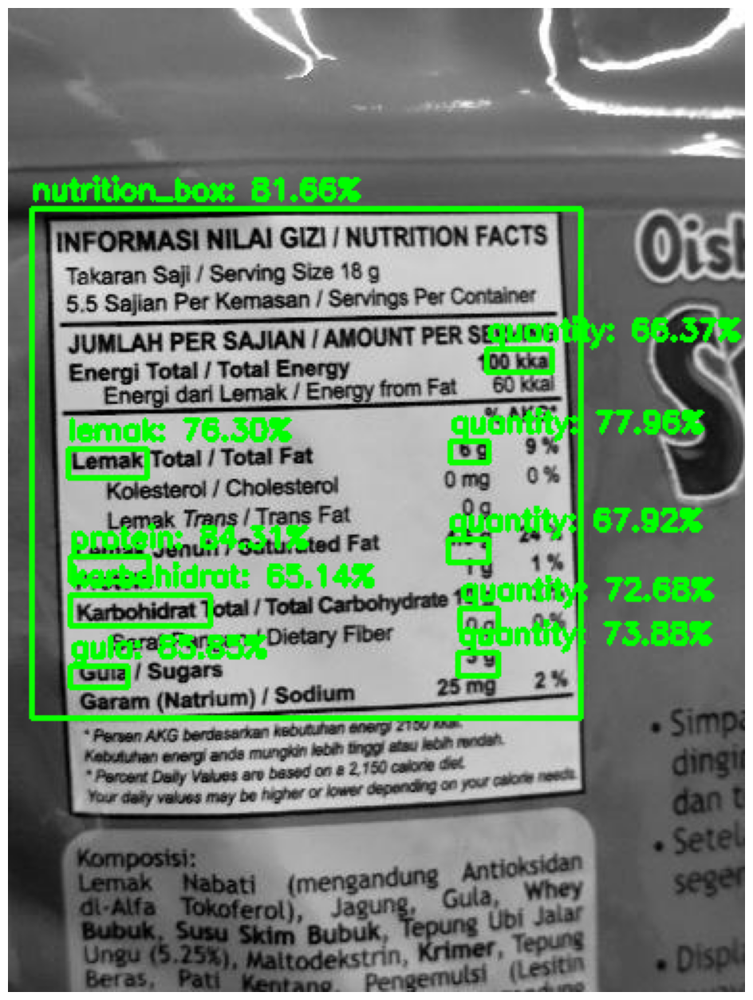

In [ ]:
# Set up variables for running user's model
PATH_TO_IMAGES='/content/drive/MyDrive/test'   # Path to test images folder
PATH_TO_MODEL='/content/custom_model_lite/detect.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/custom_model_lite/labels.txt'   # Path to labelmap.txt file
min_conf_threshold=0.5   # Confidence threshold (try changing this to 0.01 if you don't see any detection results)
images_to_test = 12   # Number of images to run detection on

# Run inferencing function!
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test)

## Calculate mAP

In [ ]:
%%bash
git clone https://github.com/Cartucho/mAP /content/mAP
cd /content/mAP
rm input/detection-results/*
rm input/ground-truth/*
rm input/images-optional/*
wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py

Cloning into '/content/mAP'...
--2024-12-06 11:40:56--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5397 (5.3K) [text/plain]
Saving to: ‘calculate_map_cartucho.py’

     0K .....                                                 100% 52.2M=0s

2024-12-06 11:40:56 (52.2 MB/s) - ‘calculate_map_cartucho.py’ saved [5397/5397]



In [ ]:
# prompt: search all file .xml

import glob

def find_xml_files(directory):
  """
  Finds all .xml files within a given directory and its subdirectories.

  Args:
    directory: The path to the directory to search.

  Returns:
    A list of strings, where each string is the full path to an .xml file.
  """
  xml_files = glob.glob(directory + '/**/*.xml', recursive=True)
  return xml_files

# Example usage
# Replace '/path/to/your/directory' with the actual path
xml_files = find_xml_files('/content/models') # Example path
xml_files

['/content/models/research/efficient-hrl/environments/assets/ant.xml']

In [ ]:
!cp -r /content/drive/MyDrive/test/* /content/mAP/input/images-optional

In [ ]:
!mv /content/mAP/input/images-optional/*.xml /content/mAP/input/ground-truth/

mv: cannot stat '/content/mAP/input/images-optional/*.xml': No such file or directory


In [ ]:
!python /content/mAP/scripts/extra/convert_gt_xml.py

Error: no .xml files found in ground-truth


In [ ]:
# Set up variables for running inference, this time to get detection results saved as .txt files
PATH_TO_IMAGES='/content/drive/MyDrive/test'   # Path to test images folder
PATH_TO_MODEL='/content/custom_model_lite/detect.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/labels.txt'   # Path to labelmap.txt file
PATH_TO_RESULTS='/content/mAP/input/detection-results' # Folder to save detection results in
min_conf_threshold=0.1   # Confidence threshold

# Use all the images in the test folder
image_list = glob.glob(PATH_TO_IMAGES + '/*.jpg') + glob.glob(PATH_TO_IMAGES + '/*.JPG') + glob.glob(PATH_TO_IMAGES + '/*.png') + glob.glob(PATH_TO_IMAGES + '/*.bmp')
images_to_test = min(500, len(image_list)) # If there are more than 500 images in the folder, just use 500

# Tell function to just save results and not display images
txt_only = True

# Run inferencing function!
print('Starting inference on %d images...' % images_to_test)
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test, PATH_TO_RESULTS, txt_only)
print('Finished inferencing!')

In [ ]:
%cd /content/mAP
!python calculate_map_cartucho.py --labels=/content/labels.txt

In [ ]:
# Output deteksi dari model
detections = model(input_tensor)

# Ambil bounding box dari deteksi
bounding_boxes = get_bounding_boxes(detections, threshold=0.5)
print("Bounding boxes:", bounding_boxes)
